<a href="https://colab.research.google.com/github/isaacyeSN/SS2021/blob/main/Day1PM/Copy_of_SS21_lab2_advanced.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Linear Regression (Multi-variable)**

**3) improve MLP model**

**(a) MLP multi-layers**

**(b) different activation**

**(c) dropout**

**(d) batch normalization**

**(e) Xavier initialization**


## 0. Import necessary modules


In [5]:
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d
from sklearn.metrics import mean_absolute_error
import argparse
import time

## 1. Data preparation

Preparing data for linear regression. Data made of combining $sin(x)$ and $log(x)$ with some random error  

$$y = \ 2 sin(x_1) + log({1 \over 2}x_2^2) + e$$  
$$ e \sim \mathcal{N} (0, 0.5) $$

As shown in the equation above, $sin(x)$ and $log(x)$ has different input $x_1$ and $x_2$ to have the output $y$. Therefore, the dataset we have has two input features for one $y$ value which requires **multivariable linear regression**.

---
The function generates total 2400 data and it is split into three parts; training, validation and testing. Each dataset has 1600, 400 and 400 respectively.

**Data Set**  
$$X_{train} \in \mathcal{R}^{1600 \times 2}, Y_{train} \in \mathcal{R}^{1600}$$  
$$X_{val} \in \mathcal{R}^{400 \times 2}, Y_{val} \in \mathcal{R}^{400}$$  
$$X_{test} \in \mathcal{R}^{400 \times 2}, Y_{test} \in \mathcal{R}^{400}$$

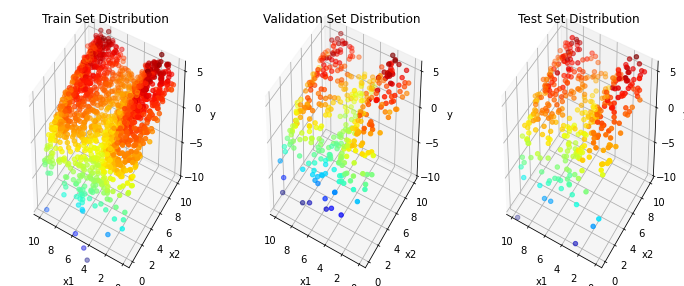

In [6]:
# ====== Data generation using Numpy ====== #
num_data = 2400
x1 = np.random.rand(num_data) * 10
x2 = np.random.rand(num_data) * 10
e = np.random.normal(0, 0.5, num_data)
X = np.array([x1, x2]).T
y = 2*np.sin(x1) + np.log(0.5*x2**2) + e

# ====== Split Dataset ====== #
train_X, train_y = X[:1600, :], y[:1600]
val_X, val_y = X[1600:2000, :], y[1600:2000]
test_X, test_y = X[2000:, :], y[2000:]

# ====== Visualize Each Dataset ====== #
fig = plt.figure(figsize=(12,5))
ax1 = fig.add_subplot(1, 3, 1, projection='3d')
ax1.scatter(train_X[:, 0], train_X[:, 1], train_y, c=train_y, cmap='jet')

ax1.set_xlabel('x1')
ax1.set_ylabel('x2')
ax1.set_zlabel('y')
ax1.set_title('Train Set Distribution')
ax1.set_zlim(-10, 6)
ax1.view_init(40, -60)
ax1.invert_xaxis()

ax2 = fig.add_subplot(1, 3, 2, projection='3d')
ax2.scatter(val_X[:, 0], val_X[:, 1], val_y, c=val_y, cmap='jet')

ax2.set_xlabel('x1')
ax2.set_ylabel('x2')
ax2.set_zlabel('y')
ax2.set_title('Validation Set Distribution')
ax2.set_zlim(-10, 6)
ax2.view_init(40, -60)
ax2.invert_xaxis()

ax3 = fig.add_subplot(1, 3, 3, projection='3d')
ax3.scatter(test_X[:, 0], test_X[:, 1], test_y, c=test_y, cmap='jet')

ax3.set_xlabel('x1')
ax3.set_ylabel('x2')
ax3.set_zlabel('y')
ax3.set_title('Test Set Distribution')
ax3.set_zlim(-10, 6)
ax3.view_init(40, -60)
ax3.invert_xaxis()

plt.show()

## 2. Model define  

Linear model is defined as $H(x) = Wx + b$ by calling `nn.Linear` module in PyTorch.

### **Linear Model**   
$$H = \ XW + b \ \ ( W \in \mathcal{R}^{2 \times 1}, b \in \mathcal{R}^{1}, H \in \mathcal{R}^{N \times 1})$$


In [7]:
class LinearModel(nn.Module):
    def __init__(self,in_dim, out_dim): 
        super(LinearModel, self).__init__()
        self.in_dim = in_dim
        self.out_dim = out_dim
        self.linear = nn.Linear(in_features=in_dim, out_features=out_dim, bias=True)
    
    def forward(self, x):
        return self.linear(x)

### **Multi Layer Perceptron**

In [8]:
class MLPModel(nn.Module):
    def __init__(self,in_dim, out_dim, hid_dim, n_layers, act, dropout, use_bn, use_xavier):  
        super(MLPModel, self).__init__()
        self.in_dim  = in_dim
        self.out_dim = out_dim
        self.hid_dim = hid_dim
        self.n_layers= n_layers
        self.act = act
        self.dropout = dropout
        self.use_bn = use_bn #True /False
        self.use_xavier = use_xavier #True /False

        self.fc = nn.Linear(self.in_dim, self.hid_dim) # first linear layer
        self.linears = nn.ModuleList()
        self.bns = nn.ModuleList()
        for i in range(self.n_layers-1):
            self.linears.append(nn.Linear(self.hid_dim, self.hid_dim))
            if self.use_bn:
                    self.bns.append(nn.BatchNorm1d(self.hid_dim))
        self.fc2= nn.Linear(self.hid_dim, self.out_dim) # last linear layer

        if self.act == 'relu':
            self.act = nn.ReLU()

        self.dropout = nn.Dropout(self.dropout)

        if self.use_xavier:
            for linear in self.linears:
                nn.init.xavier_normal_(linear.weight)
                linear.bias.data.fill_(0.01)

    def forward(self, x):
        x = self.act(self.fc(x))
        for i in range(len(self.linears)):
            x = self.act(self.linears[i](x))
            x = self.bns[i](x)
            x = self.dropout(x)
        x = self.fc2(x)
        return x

In [9]:
print(torch.cuda.is_available())
device = 'cuda:0' if torch.cuda.is_available() else 'cpu'
print(device)

True
cuda:0


## 3. Simulation Define

`pytorch` has a function named `loss.backward()` to calculate parameter gradients and then `optimizer.step()` can update all parameters using those gradient.

For every a certain amount of iteration, Test Set is tested by comparing the predicted value with true value using Mean Absolute Error. 

$$MAE(Y_{true}, Y_{predict}) = \sum_{i} | \ y_{true}^{(i)} - y_{predict}^{(i)} \ | $$

In [10]:
def experiment(args):

    model = MLPModel(args.in_dim, args.out_dim, args.hid_dim, args.n_layers, args.act, args.dropout, args.use_bn, args.use_xavier)

    print(model)

    # ===== Copy model to Device ===== #
    model.to(device)
    
    # ====== Loss function ====== #
    criterion = nn.MSELoss()
    optimizer = optim.SGD(model.parameters(), lr=args.lr, momentum=args.momentum)

    # ====== Data collection ====== #
    list_epoch = [] 
    list_train_loss = []
    list_val_loss = []
    list_acc = []
    list_acc_epoch = []

    # ====== Loop ====== #
    for epoch in range(args.epoch):  
        
        # ====== Train ====== #
        model.train() # Set the model be 'train mode' 
        optimizer.zero_grad() # Initialize the gradient in the optimizer
        
        input_x = torch.Tensor(train_X)
        true_y = torch.Tensor(train_y)

        # ===== Transfer data to GPU ===== #
        input_x = input_x.to(device)
        true_y = true_y.to(device)
        
        pred_y = model(input_x)

        loss = criterion(pred_y.squeeze(), true_y)
        loss.backward() # Calculating gradients 
        optimizer.step() # Updating gradients 
        list_epoch.append(epoch)
        list_train_loss.append(loss.item()) #= loss.item()
        
        # ====== Validation ====== #
        model.eval()
        optimizer.zero_grad()
        input_x = torch.Tensor(val_X)
        true_y = torch.Tensor(val_y)

        # ===== Transfer data to GPU ===== #
        input_x = input_x.to(device)
        true_y = true_y.to(device)

        pred_y = model(input_x) 

        loss = criterion(pred_y.squeeze(), true_y)
        list_val_loss.append(loss.item())
        
        # ====== Evaluation ======= #
        if epoch % 20 == 0: 
            
            # ====== Calculate Accuracy ====== #
            model.eval()
            with torch.no_grad():
                input_x = torch.Tensor(test_X)
                true_y = torch.Tensor(test_y)

                # ===== Transfer data to GPU ===== #
                input_x = input_x.to(device)
    #           true_y = true_y.to(device)

                # ===== Copy back to CPU for skLearn ===== #
                pred_y = model(input_x).cpu()

                acc = mean_absolute_error(true_y, pred_y.squeeze().numpy()) # sklearn 
                list_acc.append(acc)
                list_acc_epoch.append(epoch)
                
                fig = plt.figure(figsize=(15,5))
                
                # ====== True Y Scattering ====== #
                ax1 = fig.add_subplot(1, 3, 1, projection='3d')
                ax1.scatter(test_X[:, 0], test_X[:, 1], test_y, c=test_y, cmap='jet')
                
                ax1.set_xlabel('x1')
                ax1.set_ylabel('x2')
                ax1.set_zlabel('y')
                ax1.set_zlim(-10, 6)
                ax1.view_init(40, -40)
                ax1.set_title('True test y')
                ax1.invert_xaxis()

                # ====== Predicted Y Scattering ====== #
                ax2 = fig.add_subplot(1, 3, 2, projection='3d')
                ax2.scatter(test_X[:, 0], test_X[:, 1], pred_y, c=pred_y[:,0], cmap='jet')

                ax2.set_xlabel('x1')
                ax2.set_ylabel('x2')
                ax2.set_zlabel('y')
                ax2.set_zlim(-10, 6)
                ax2.view_init(40, -40)
                ax2.set_title('Predicted test y')
                ax2.invert_xaxis()

                # ====== Just for Visualizaing with High Resolution ====== #
                input_x = torch.Tensor(train_X)

                # ===== Transfer data to GPU ===== #
                input_x = input_x.to(device)

                pred_y = model(input_x).cpu() 
                
                ax3 = fig.add_subplot(1, 3, 3, projection='3d')
                ax3.scatter(train_X[:, 0], train_X[:, 1], pred_y, c=pred_y[:,0], cmap='jet')

                ax3.set_xlabel('x1')
                ax3.set_ylabel('x2')
                ax3.set_zlabel('y')
                ax3.set_zlim(-10, 6)
                ax3.view_init(40, -40)
                ax3.set_title('Predicted train y')
                ax3.invert_xaxis()
                
                plt.show()
                print(f'\n Epoch: {epoch}, loss: {loss.item():.4f}')

    return list_epoch, list_train_loss, list_val_loss, list_acc, list_acc_epoch

## 4. Train & Evaluation

MLPModel(
  (fc): Linear(in_features=2, out_features=100, bias=True)
  (linears): ModuleList(
    (0): Linear(in_features=100, out_features=100, bias=True)
    (1): Linear(in_features=100, out_features=100, bias=True)
    (2): Linear(in_features=100, out_features=100, bias=True)
    (3): Linear(in_features=100, out_features=100, bias=True)
  )
  (bns): ModuleList(
    (0): BatchNorm1d(100, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (1): BatchNorm1d(100, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): BatchNorm1d(100, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): BatchNorm1d(100, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (fc2): Linear(in_features=100, out_features=1, bias=True)
  (act): ReLU()
  (dropout): Dropout(p=0.1, inplace=False)
)


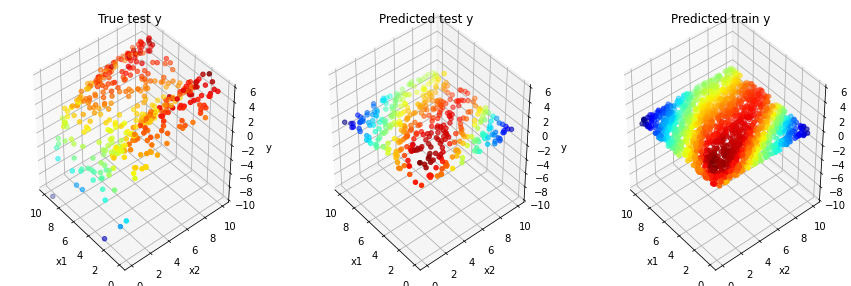


 Epoch: 0, loss: 10.7661


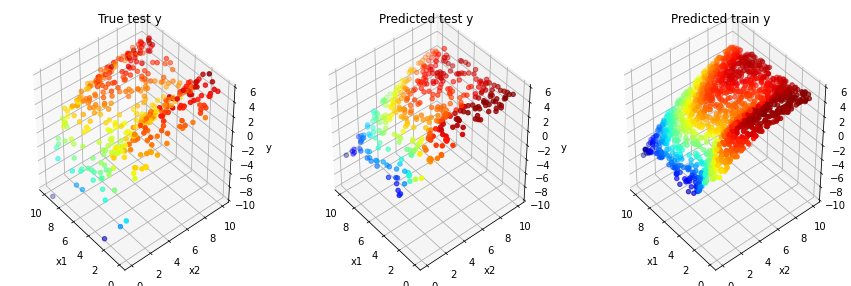


 Epoch: 20, loss: 2.7716


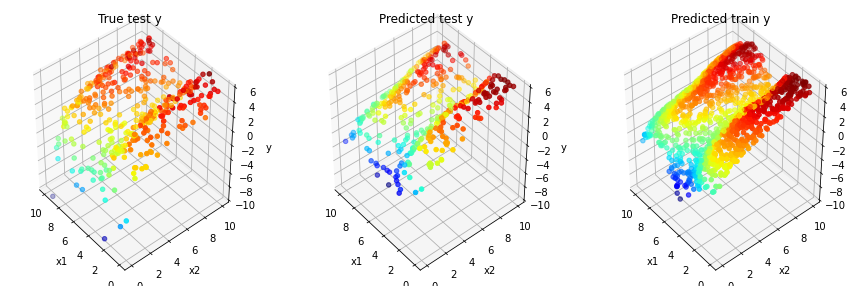


 Epoch: 40, loss: 0.9794


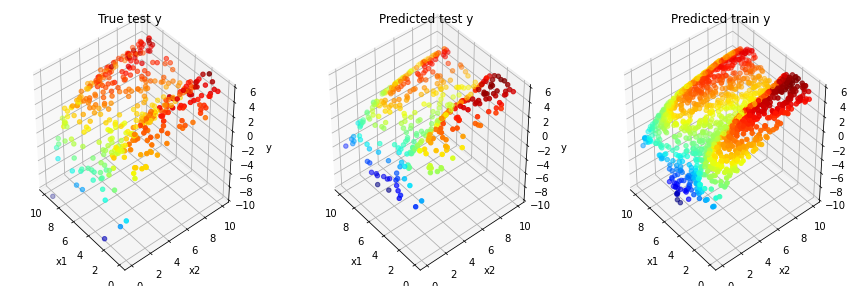


 Epoch: 60, loss: 0.6322


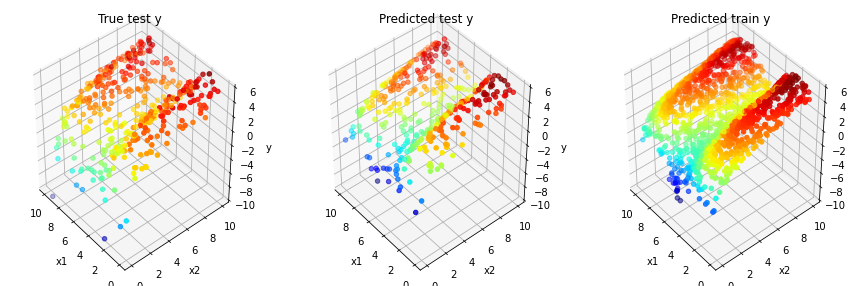


 Epoch: 80, loss: 0.5955


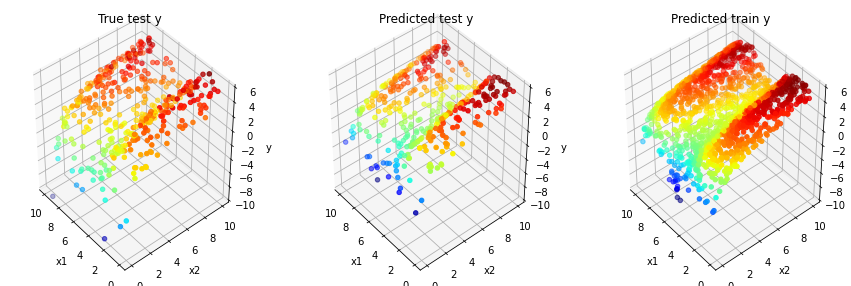


 Epoch: 100, loss: 0.7203


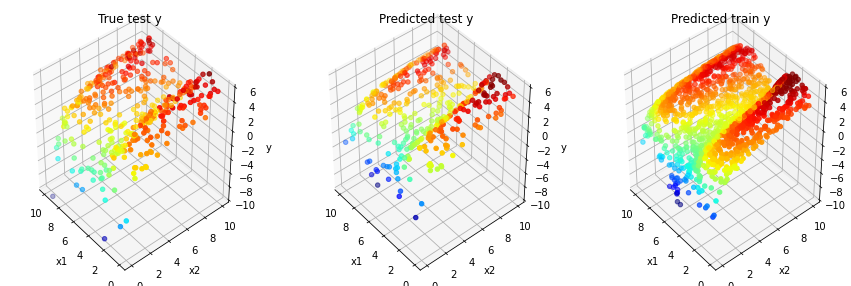


 Epoch: 120, loss: 0.6695


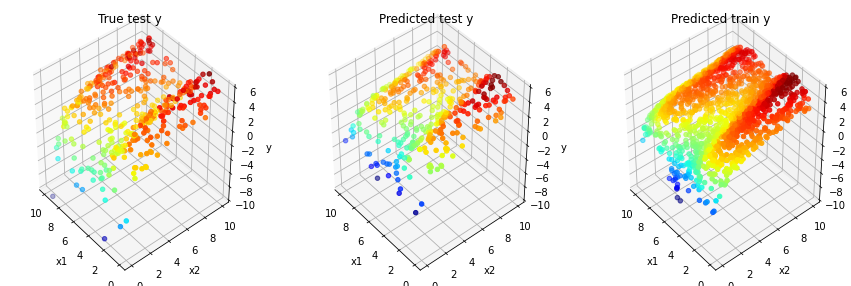


 Epoch: 140, loss: 0.9120


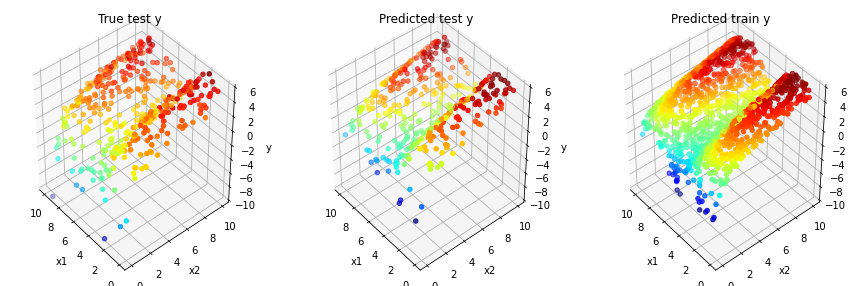


 Epoch: 160, loss: 0.8595


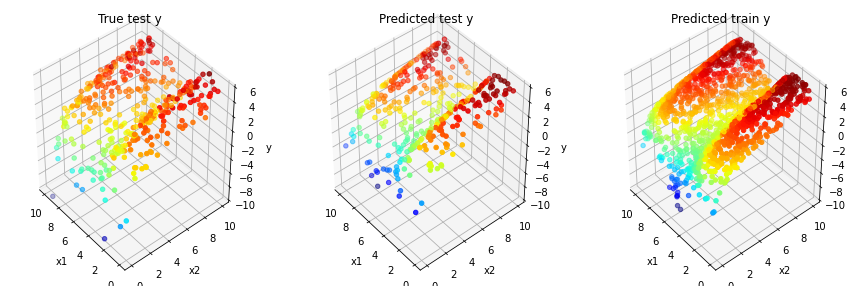


 Epoch: 180, loss: 0.5162


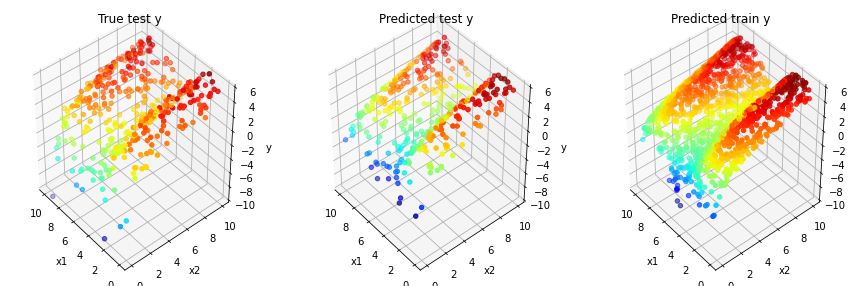


 Epoch: 200, loss: 0.5328


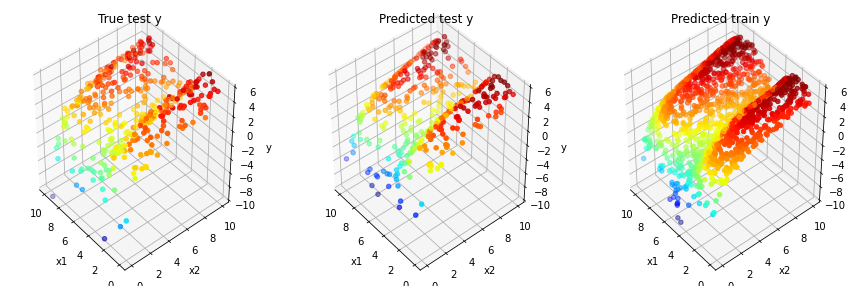


 Epoch: 220, loss: 0.3832


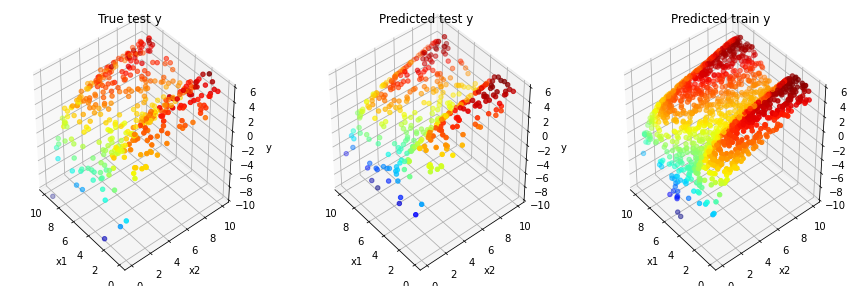


 Epoch: 240, loss: 0.4430


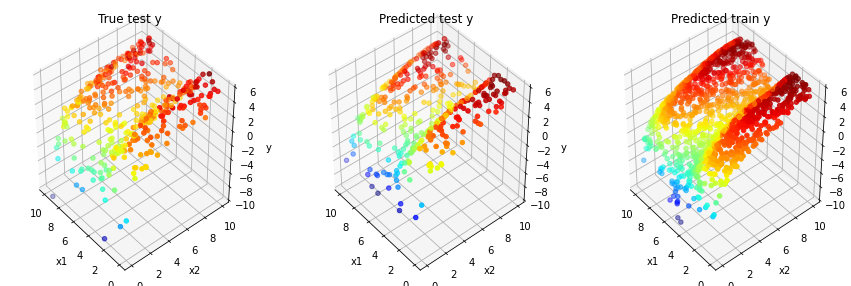


 Epoch: 260, loss: 0.3766


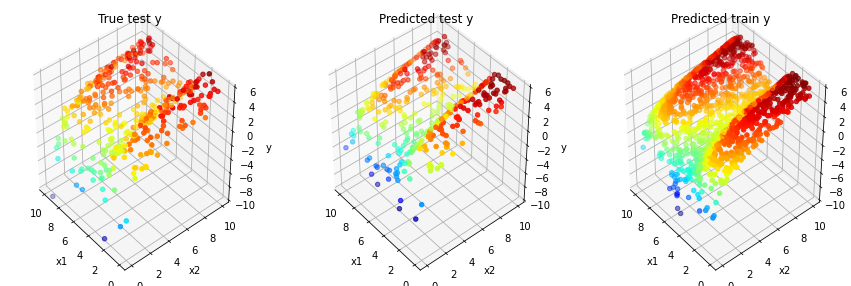


 Epoch: 280, loss: 0.4985


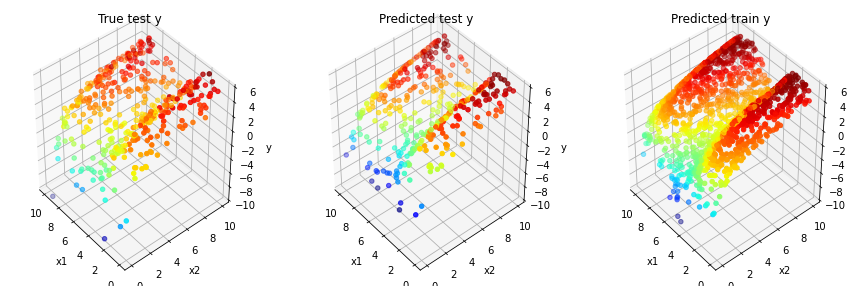


 Epoch: 300, loss: 0.3883


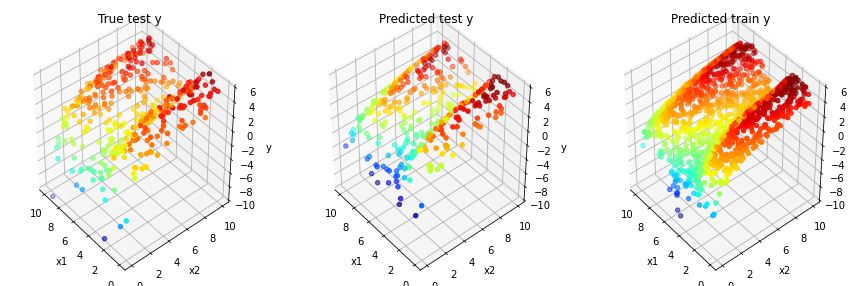


 Epoch: 320, loss: 0.4913


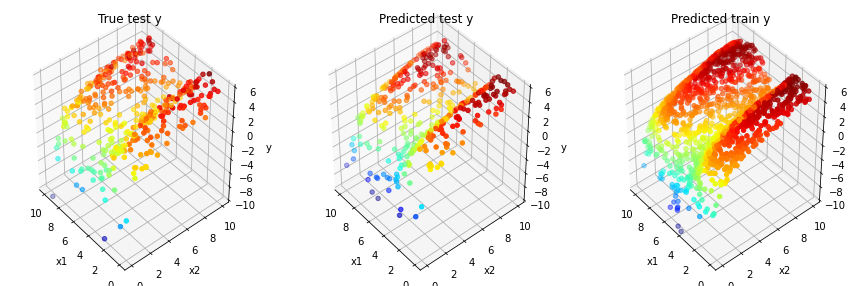


 Epoch: 340, loss: 0.3828


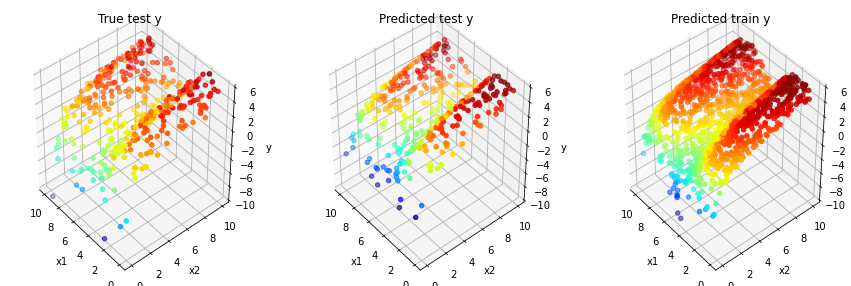


 Epoch: 360, loss: 0.4104


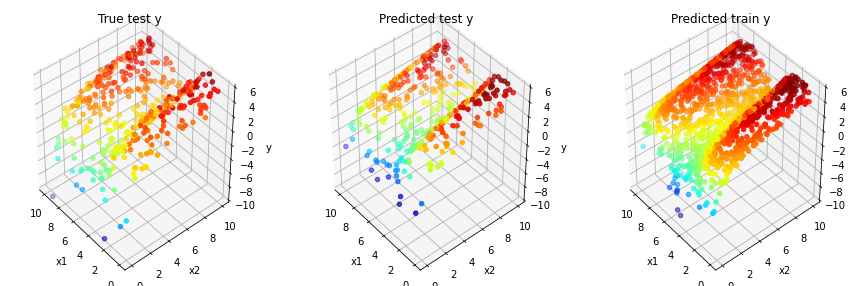


 Epoch: 380, loss: 0.6547


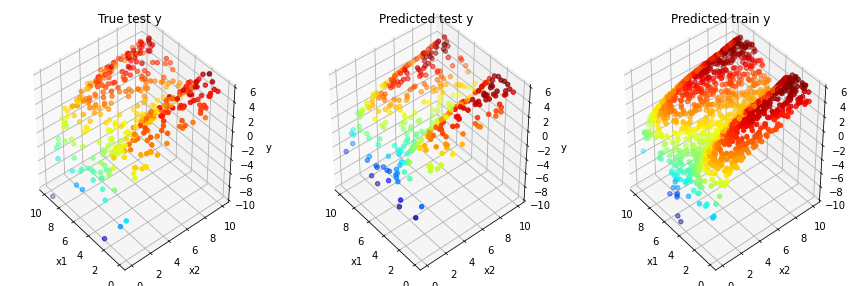


 Epoch: 400, loss: 0.4434


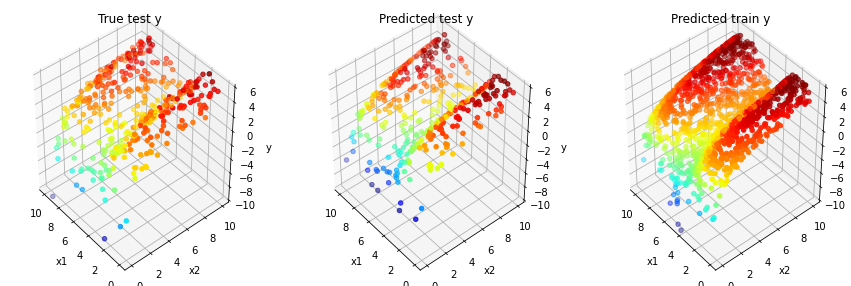


 Epoch: 420, loss: 0.4062


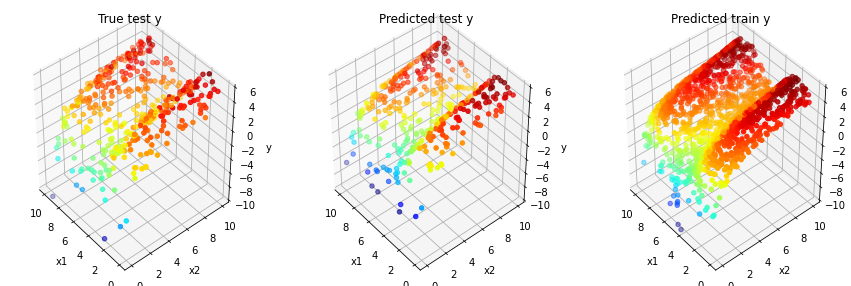


 Epoch: 440, loss: 0.3641


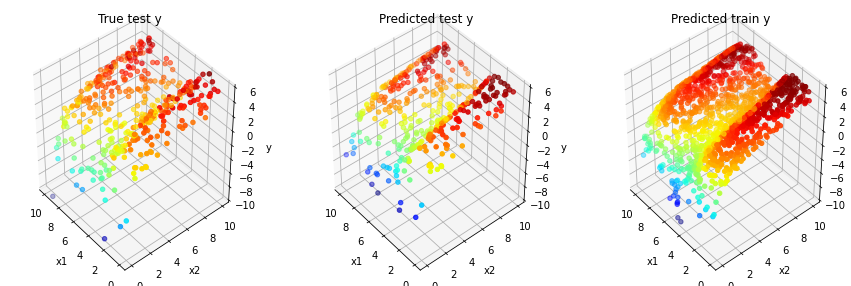


 Epoch: 460, loss: 0.4321


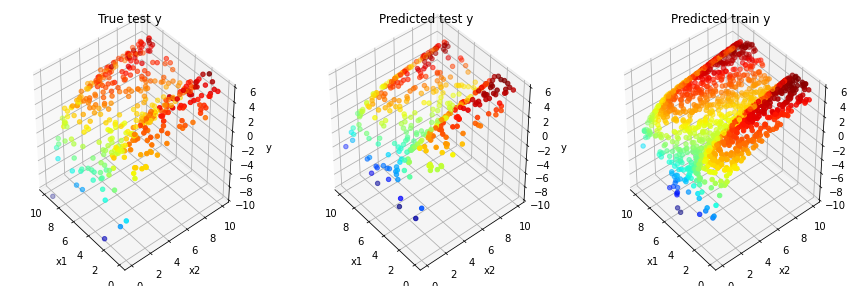


 Epoch: 480, loss: 0.4948


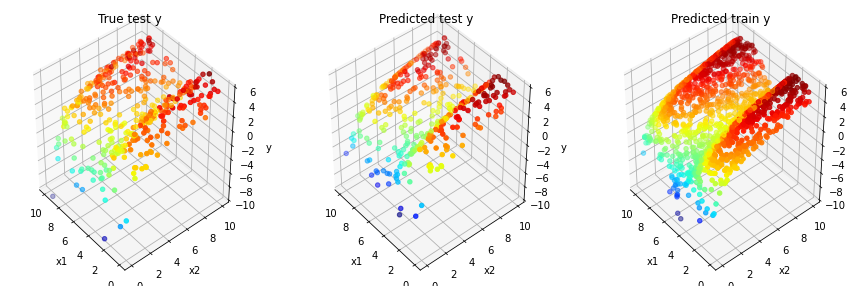


 Epoch: 500, loss: 0.3655


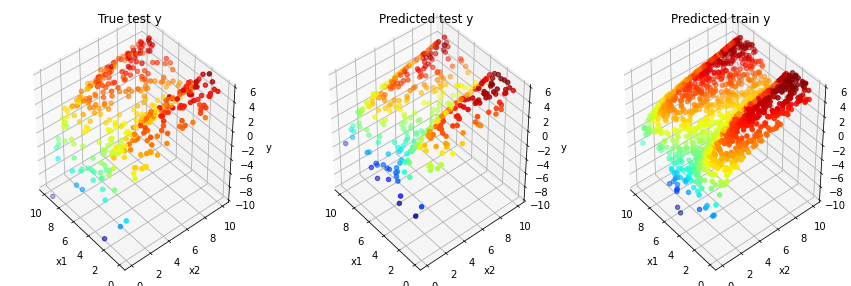


 Epoch: 520, loss: 0.6331


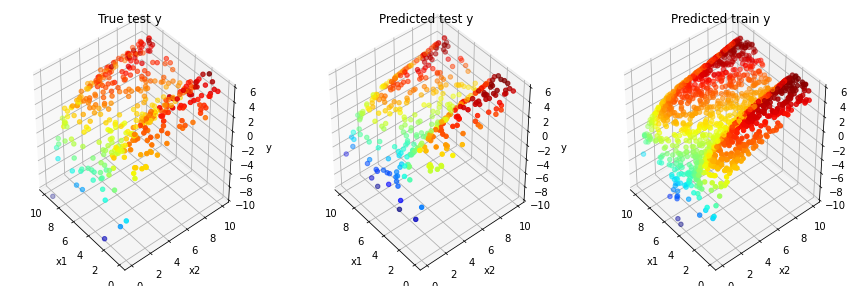


 Epoch: 540, loss: 0.3649


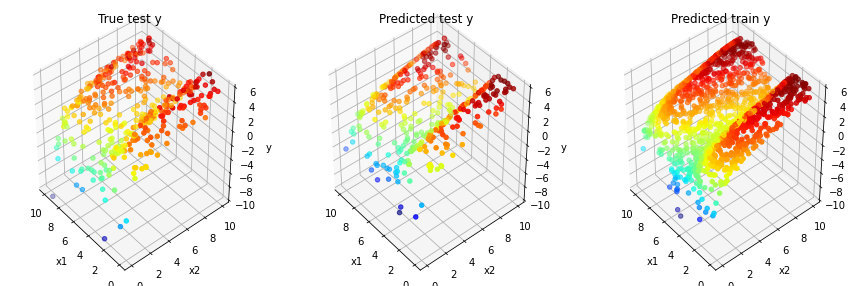


 Epoch: 560, loss: 0.4701


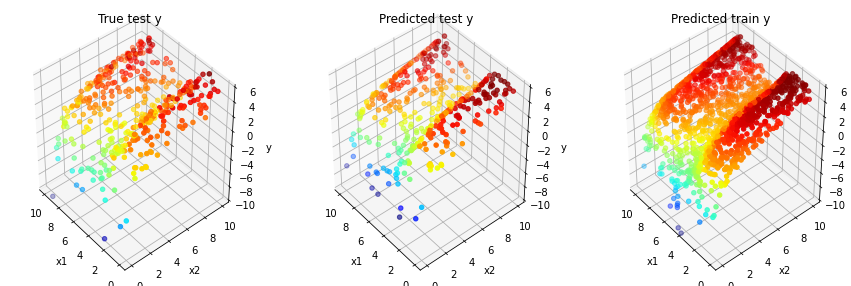


 Epoch: 580, loss: 0.4799


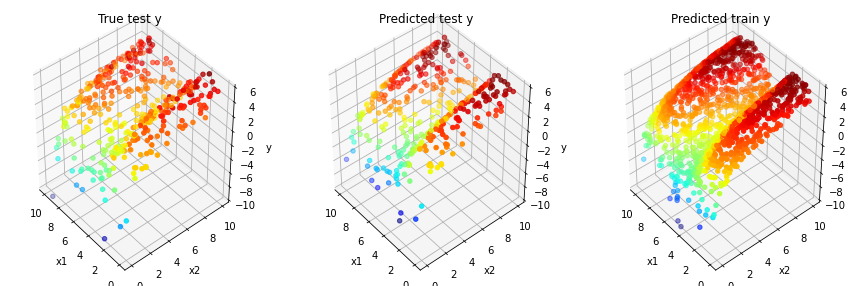


 Epoch: 600, loss: 0.3825


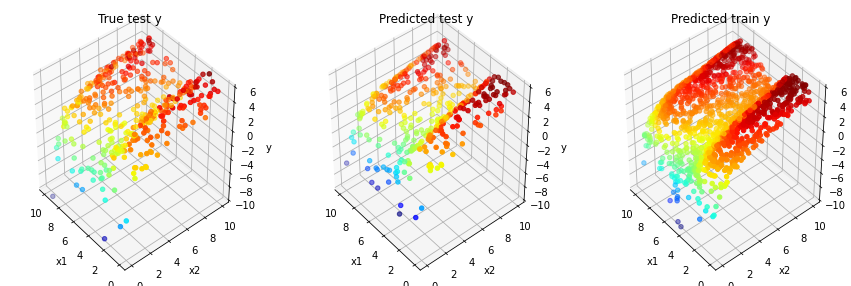


 Epoch: 620, loss: 0.3765


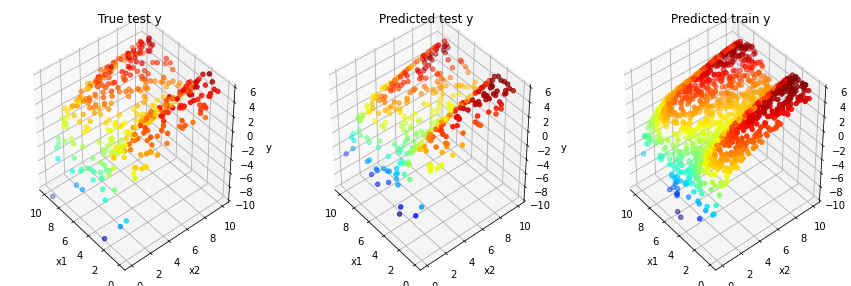


 Epoch: 640, loss: 0.3743


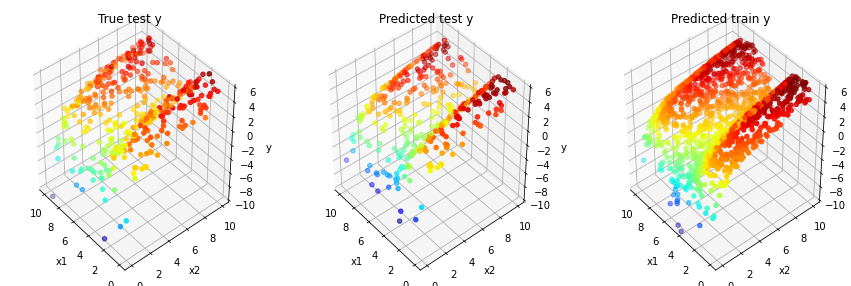


 Epoch: 660, loss: 0.3773


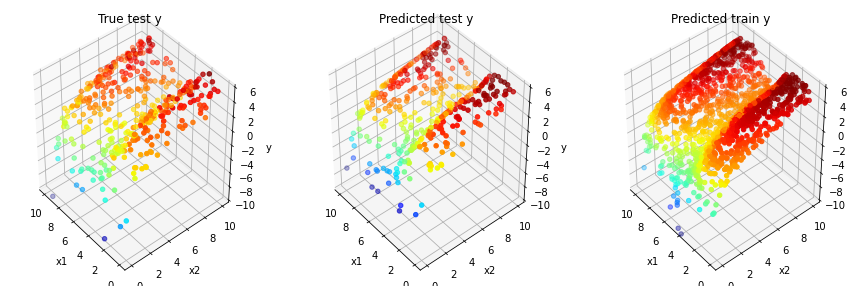


 Epoch: 680, loss: 0.4128


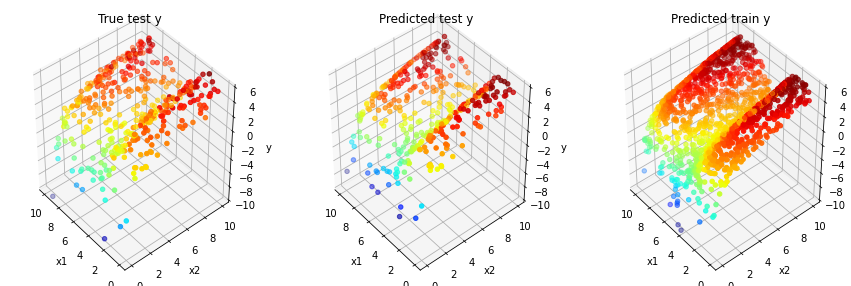


 Epoch: 700, loss: 0.3481


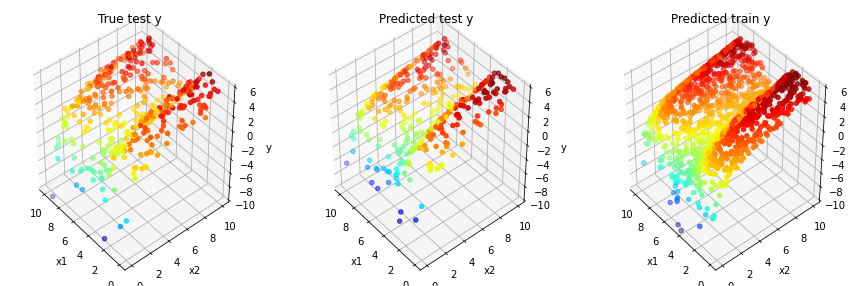


 Epoch: 720, loss: 0.4080


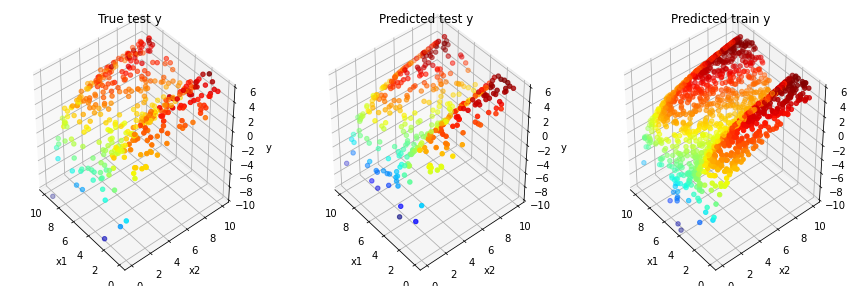


 Epoch: 740, loss: 0.3540


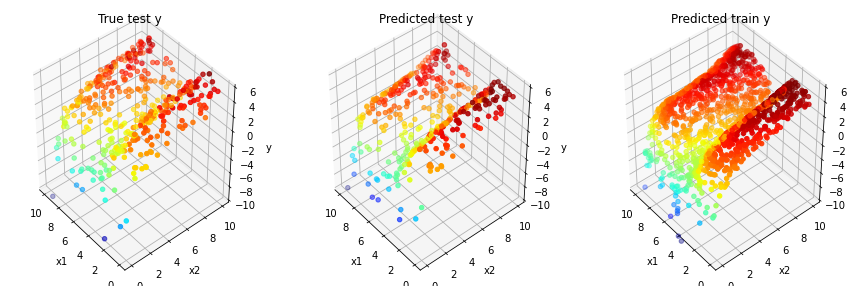


 Epoch: 760, loss: 0.9142


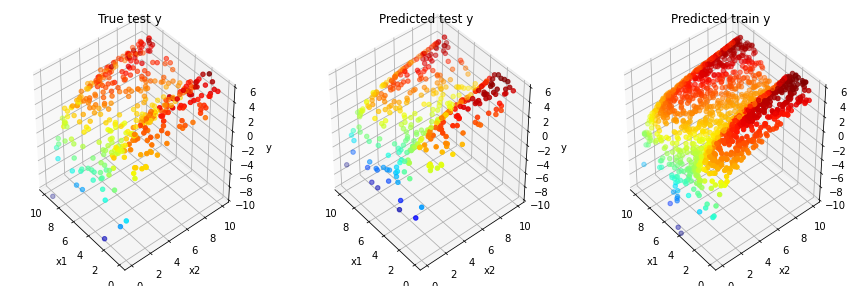


 Epoch: 780, loss: 0.4382


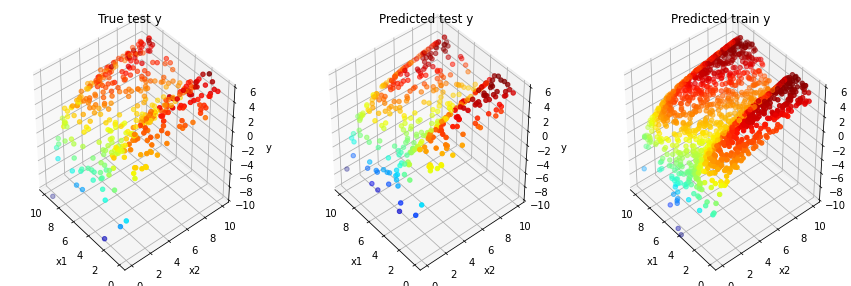


 Epoch: 800, loss: 0.3267


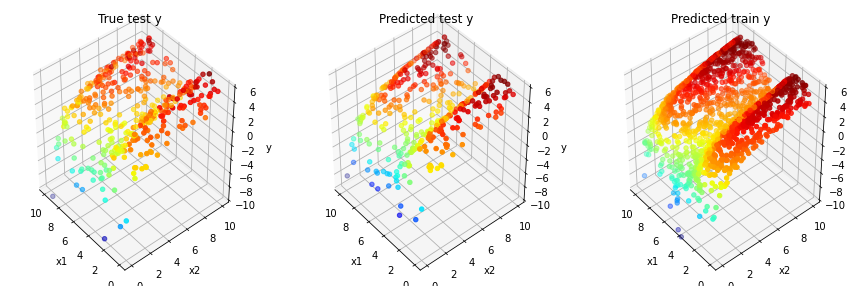


 Epoch: 820, loss: 0.3070


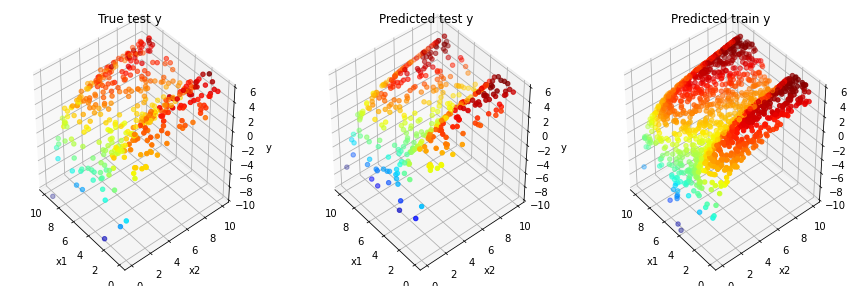


 Epoch: 840, loss: 0.3469


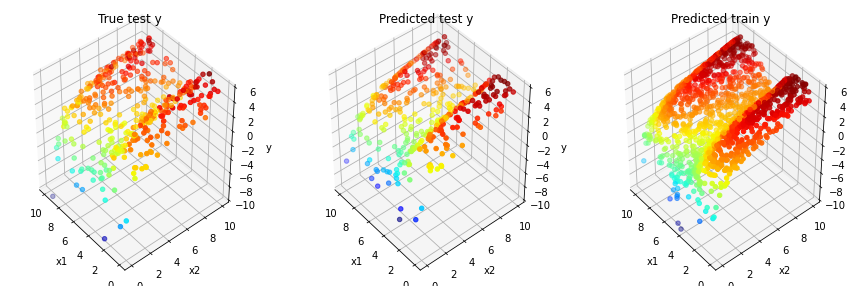


 Epoch: 860, loss: 0.3438


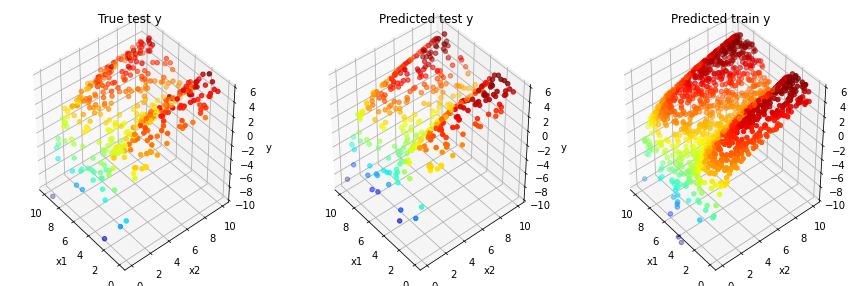


 Epoch: 880, loss: 0.3777


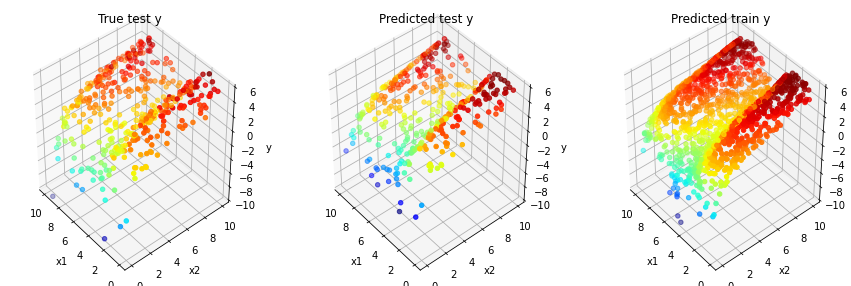


 Epoch: 900, loss: 0.4244


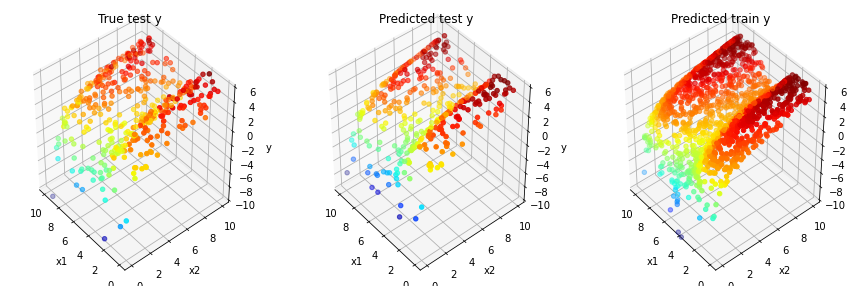


 Epoch: 920, loss: 0.3882


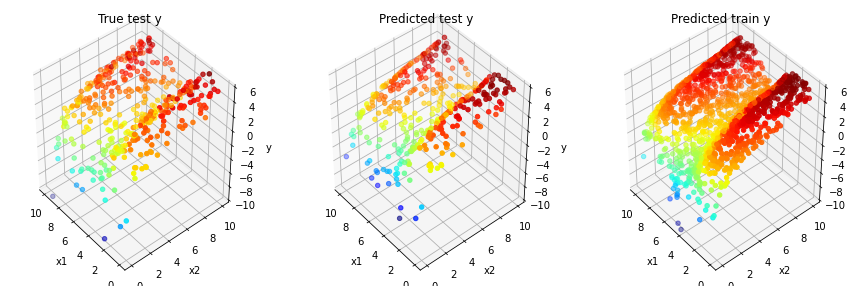


 Epoch: 940, loss: 0.4291


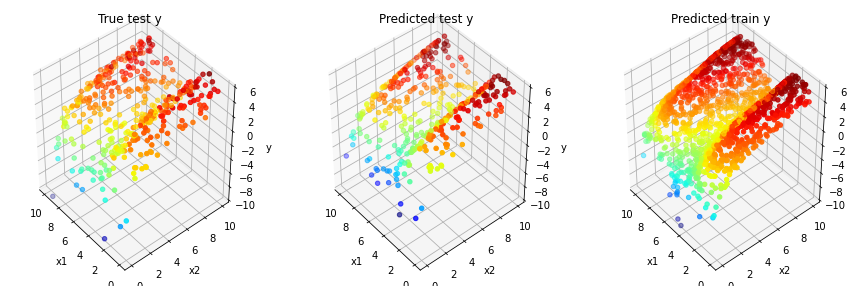


 Epoch: 960, loss: 0.3669


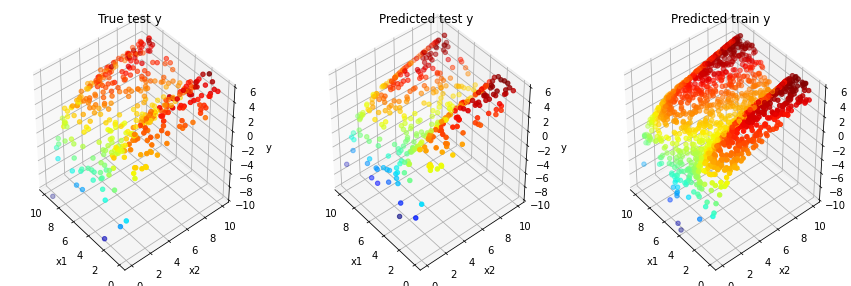


 Epoch: 980, loss: 0.3451


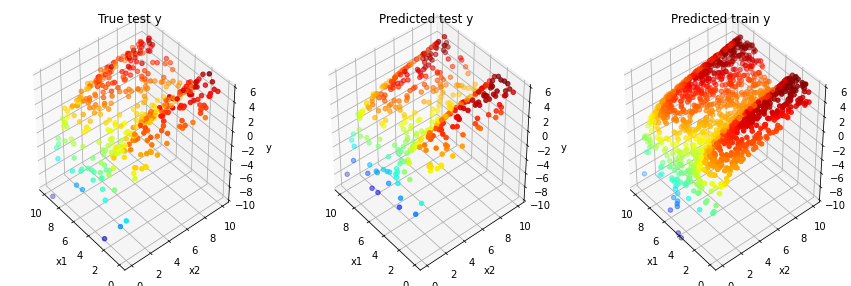


 Epoch: 1000, loss: 0.3406


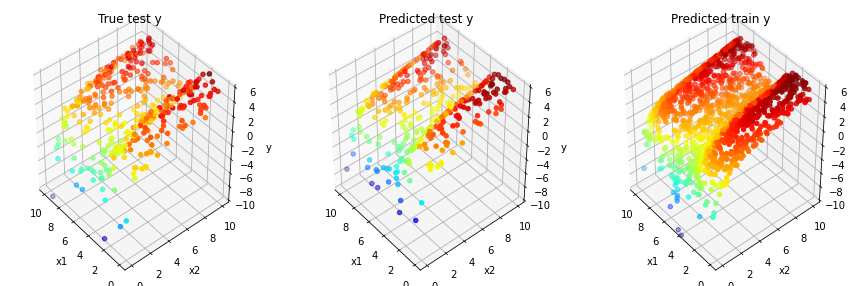


 Epoch: 1020, loss: 0.4885


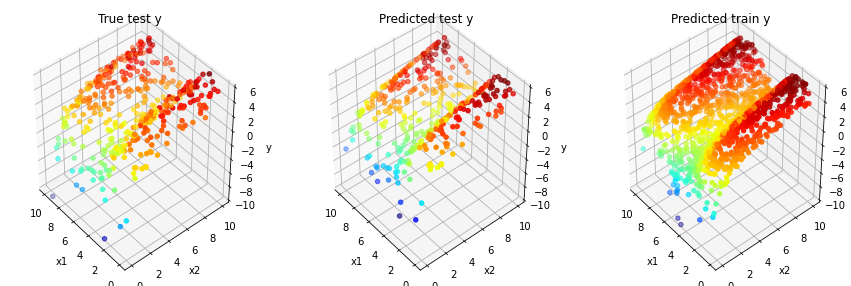


 Epoch: 1040, loss: 0.4617


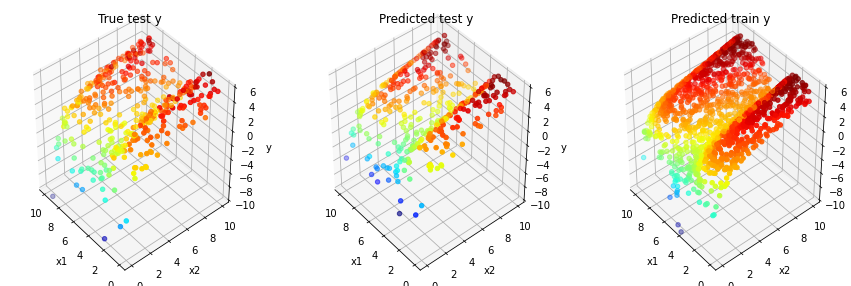


 Epoch: 1060, loss: 0.4715


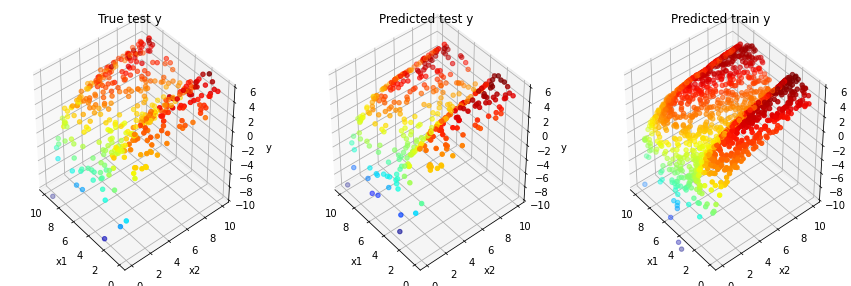


 Epoch: 1080, loss: 0.3759


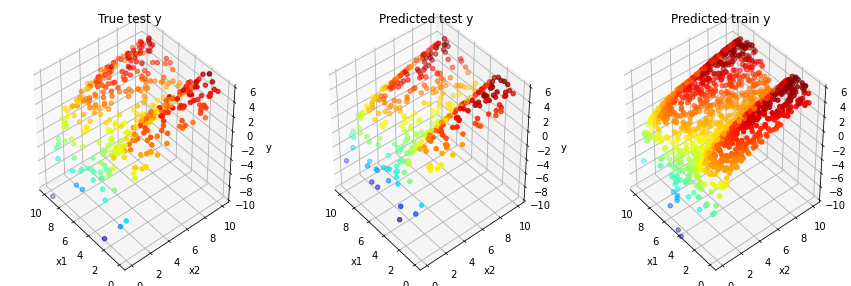


 Epoch: 1100, loss: 0.3483


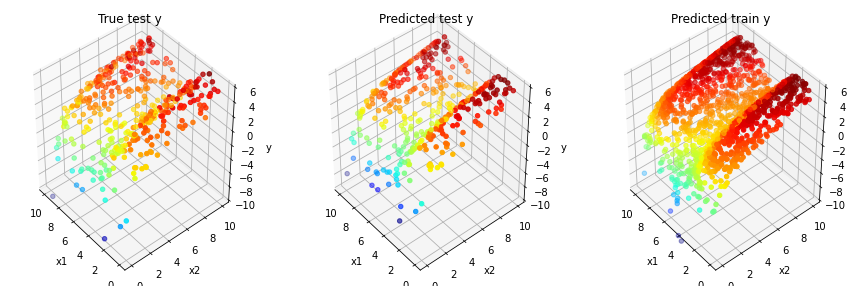


 Epoch: 1120, loss: 0.3853


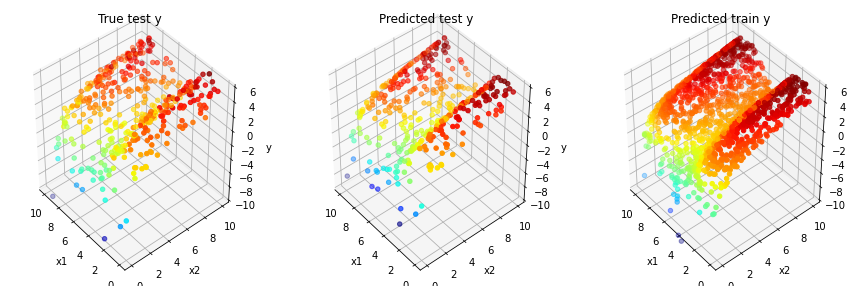


 Epoch: 1140, loss: 0.3507


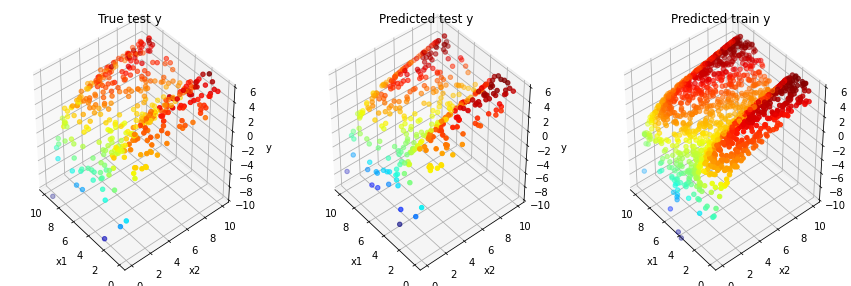


 Epoch: 1160, loss: 0.3211


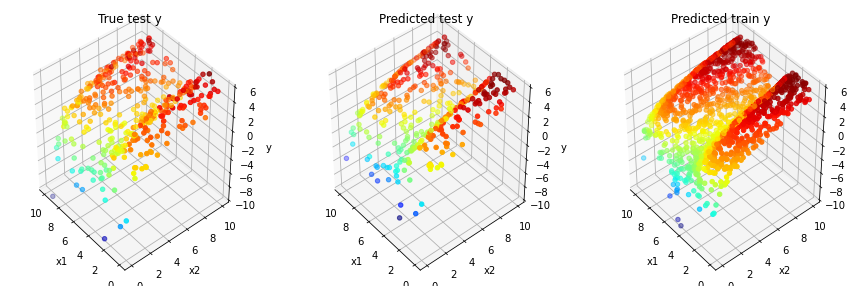


 Epoch: 1180, loss: 0.5068


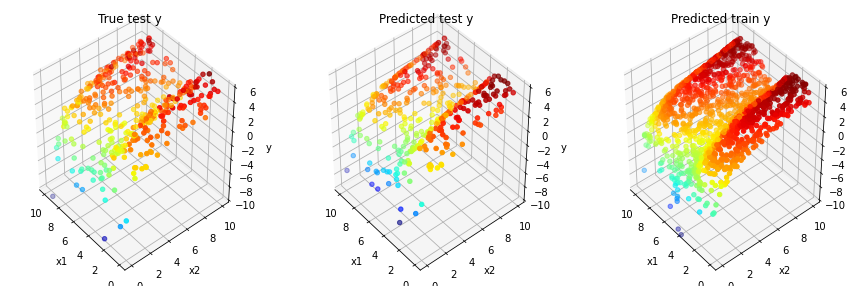


 Epoch: 1200, loss: 0.3341


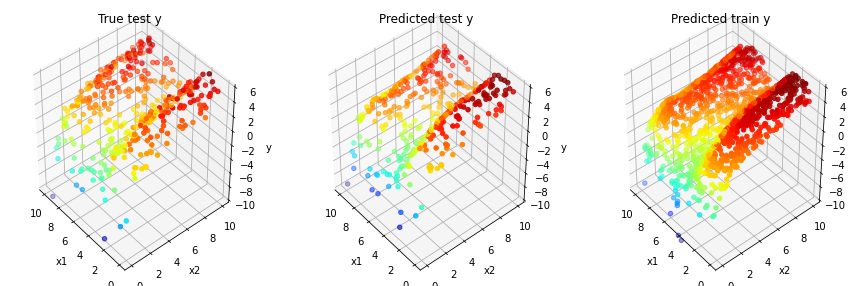


 Epoch: 1220, loss: 0.6370


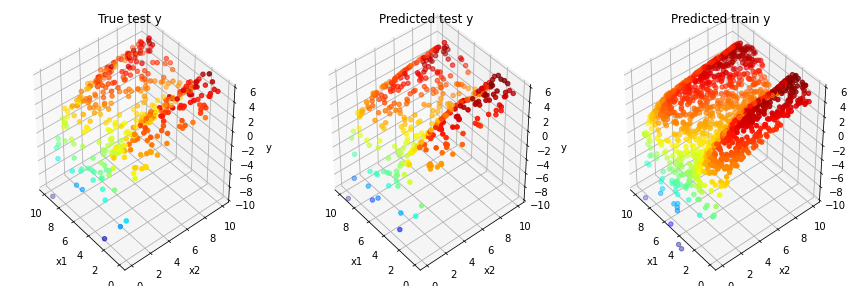


 Epoch: 1240, loss: 0.4031


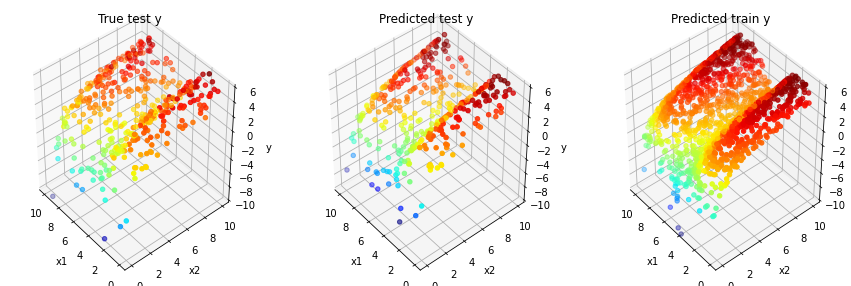


 Epoch: 1260, loss: 0.3188


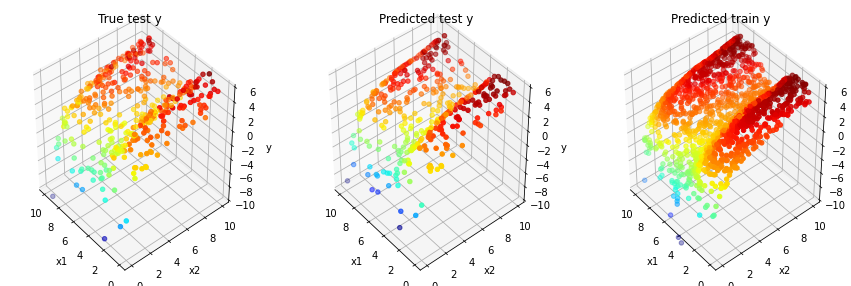


 Epoch: 1280, loss: 0.3696


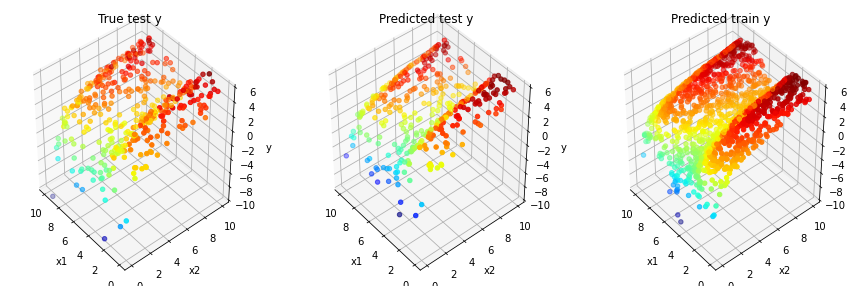


 Epoch: 1300, loss: 0.4286


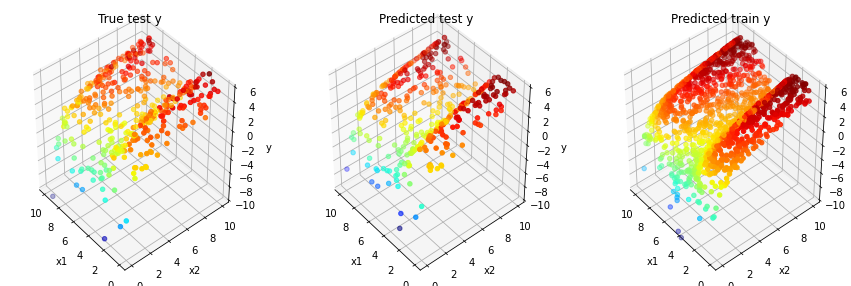


 Epoch: 1320, loss: 0.3517


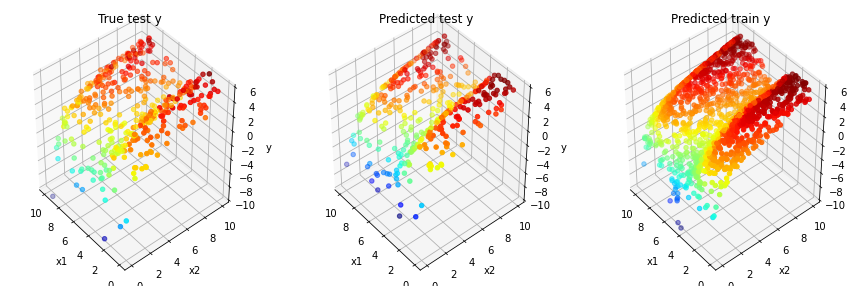


 Epoch: 1340, loss: 0.3794


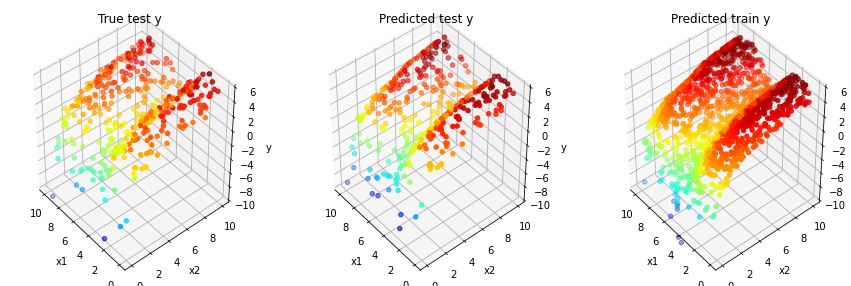


 Epoch: 1360, loss: 0.3671


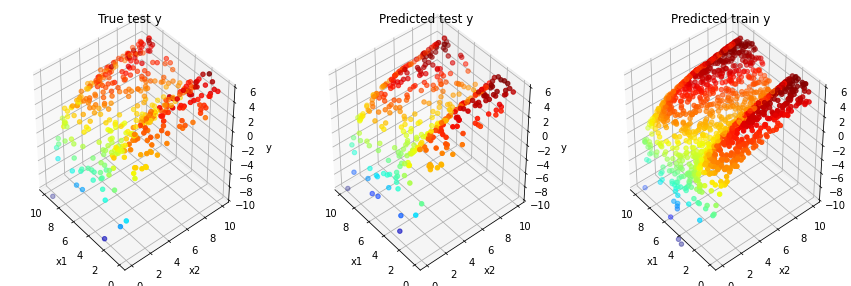


 Epoch: 1380, loss: 0.3358


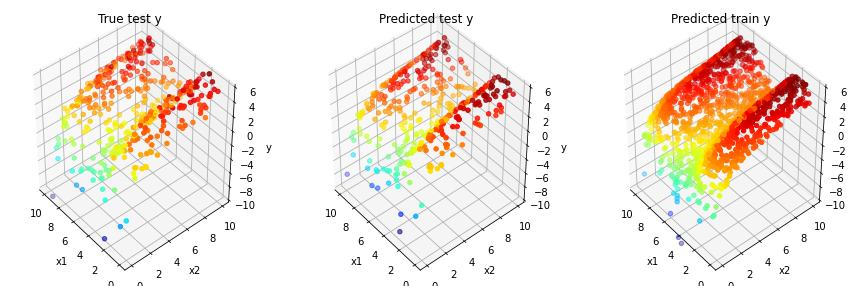


 Epoch: 1400, loss: 0.3231


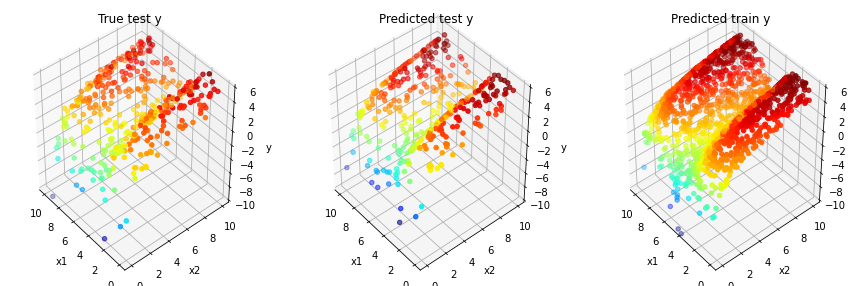


 Epoch: 1420, loss: 0.3981


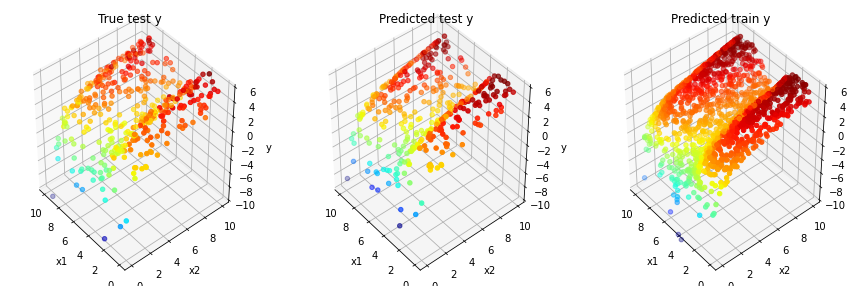


 Epoch: 1440, loss: 0.3228


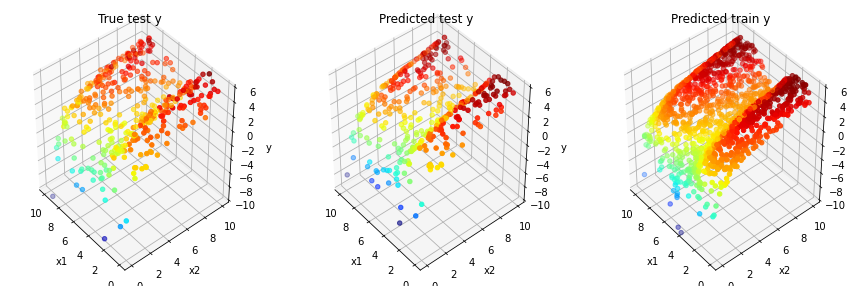


 Epoch: 1460, loss: 0.3255


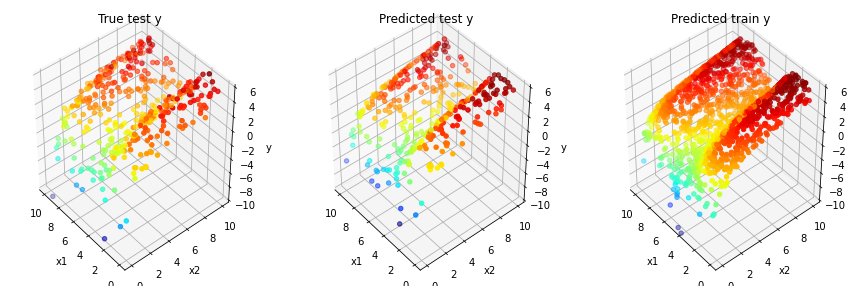


 Epoch: 1480, loss: 0.3930


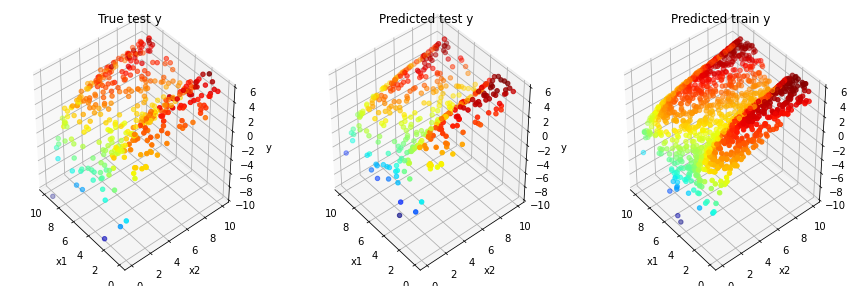


 Epoch: 1500, loss: 0.5022


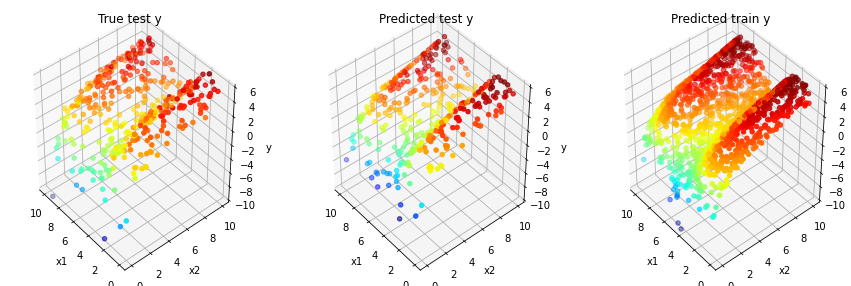


 Epoch: 1520, loss: 0.3293


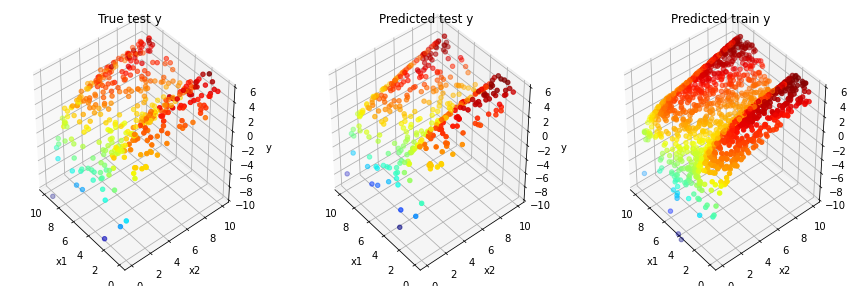


 Epoch: 1540, loss: 0.3983


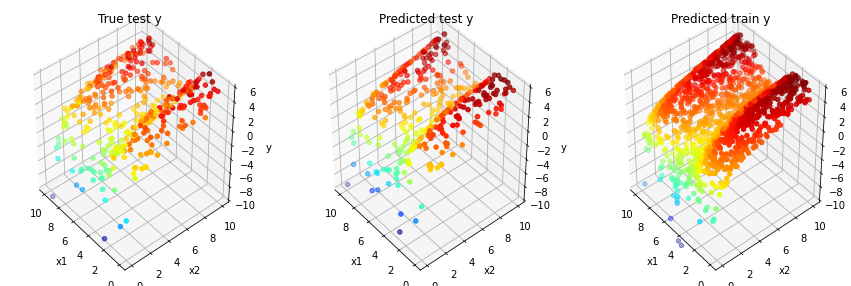


 Epoch: 1560, loss: 0.4714


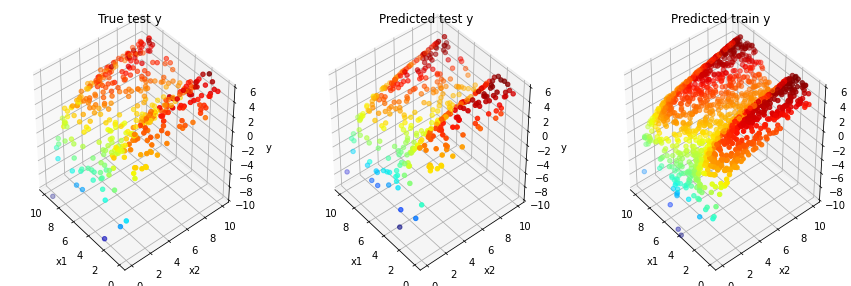


 Epoch: 1580, loss: 0.3090


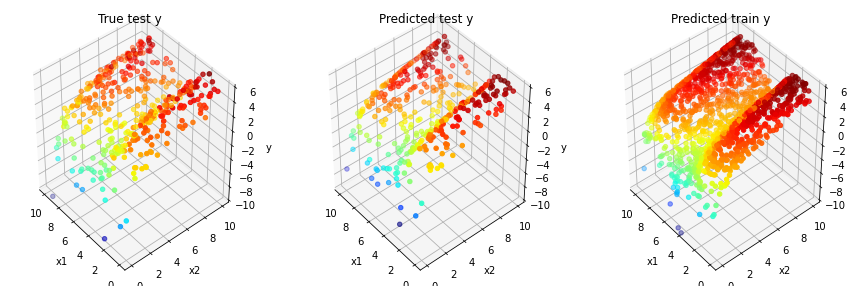


 Epoch: 1600, loss: 0.3810


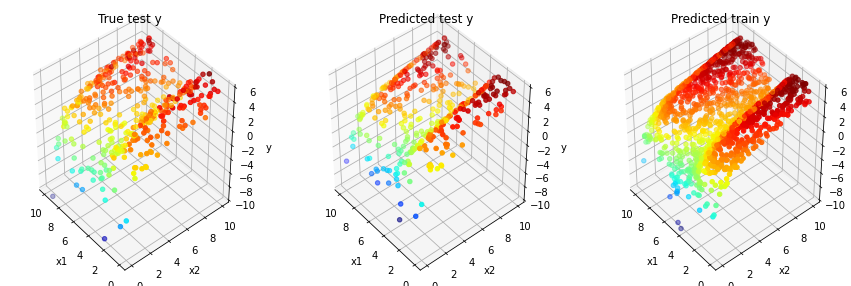


 Epoch: 1620, loss: 0.3815


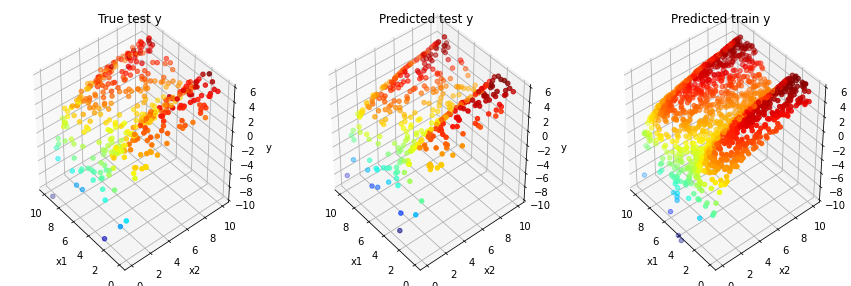


 Epoch: 1640, loss: 0.3697


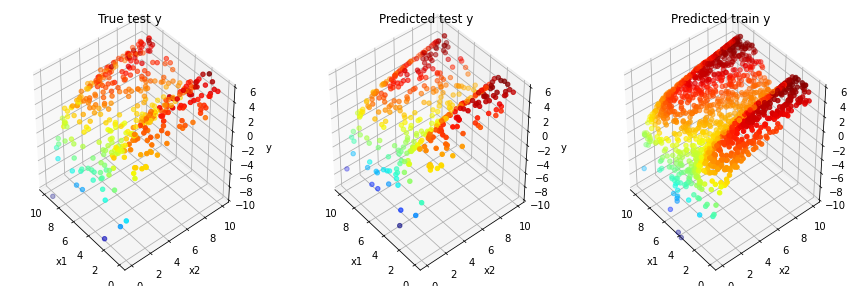


 Epoch: 1660, loss: 0.3645


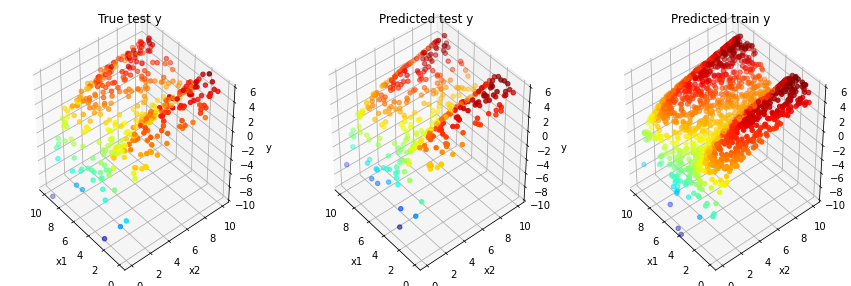


 Epoch: 1680, loss: 0.4142


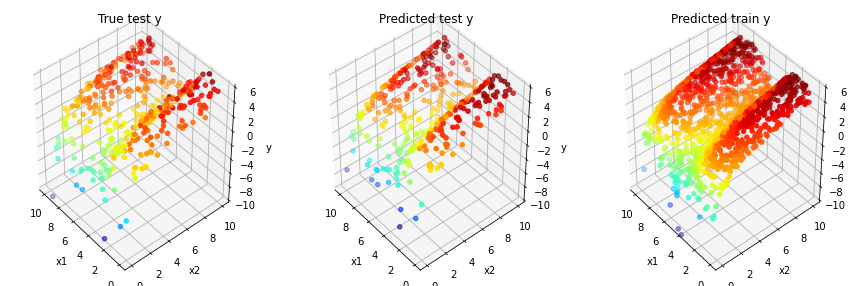


 Epoch: 1700, loss: 0.3553


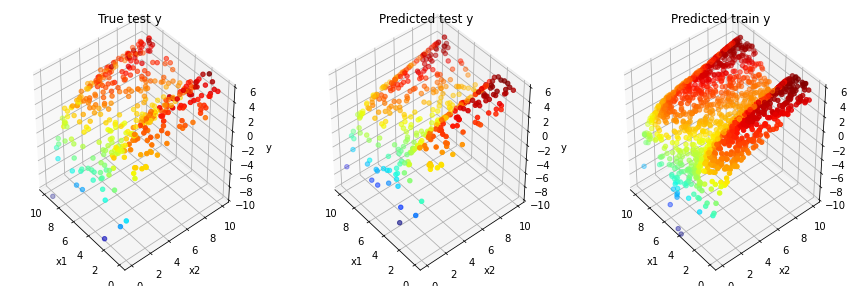


 Epoch: 1720, loss: 0.3737


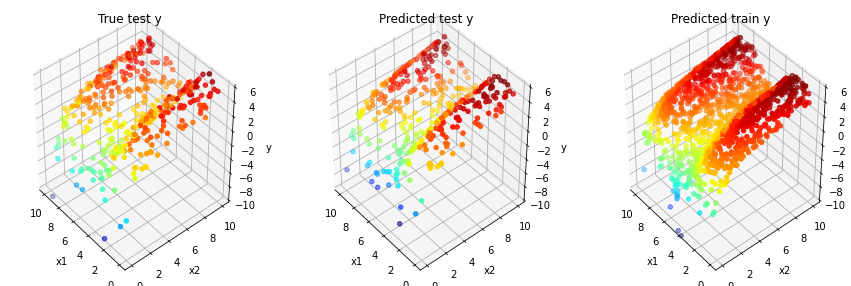


 Epoch: 1740, loss: 0.4077


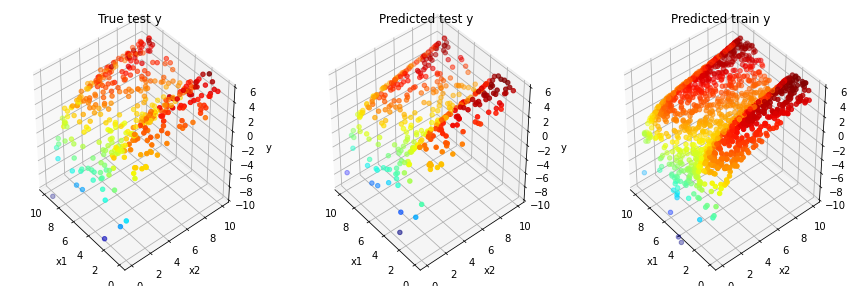


 Epoch: 1760, loss: 0.3796


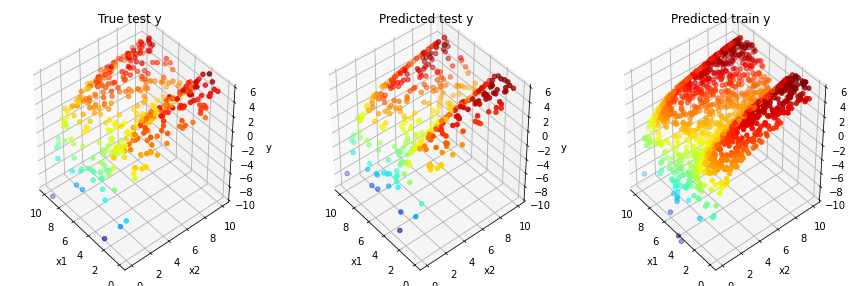


 Epoch: 1780, loss: 0.3311


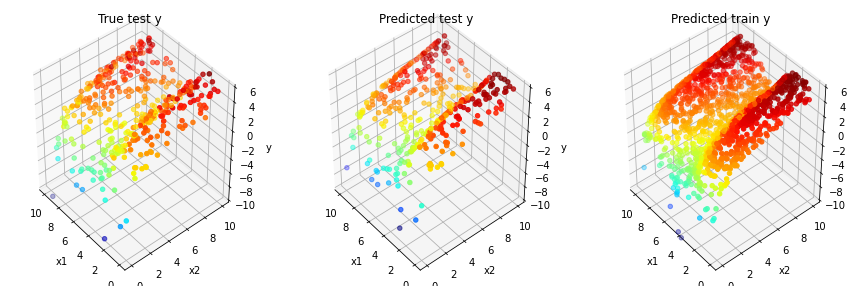


 Epoch: 1800, loss: 0.4235


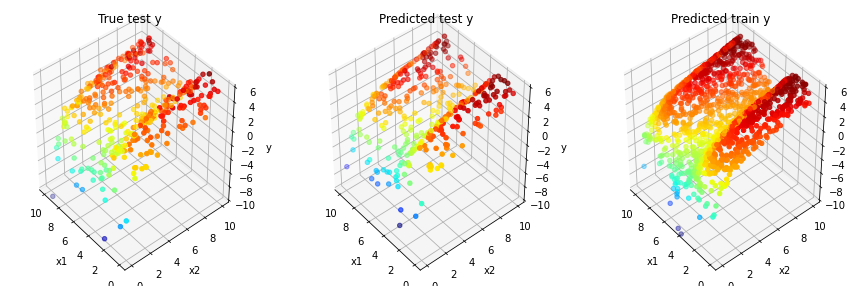


 Epoch: 1820, loss: 0.3326


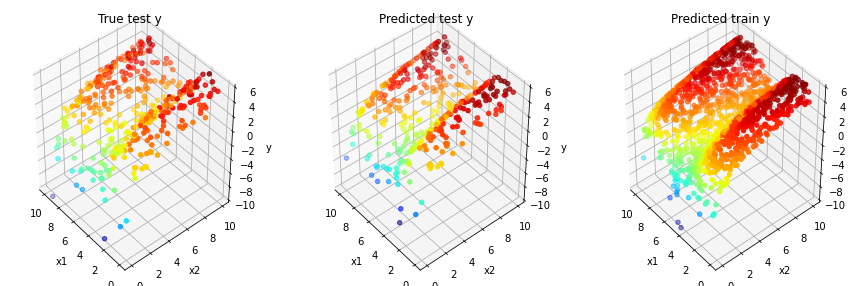


 Epoch: 1840, loss: 0.4590


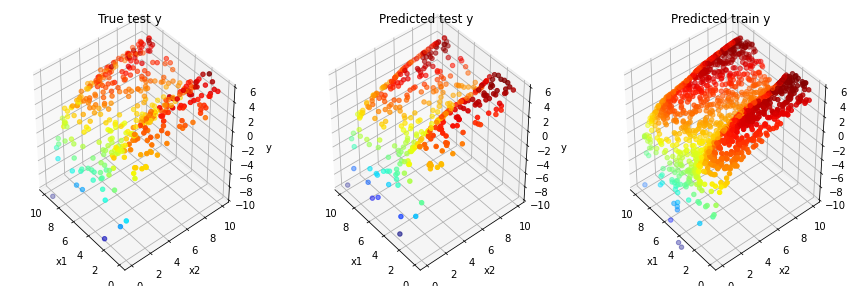


 Epoch: 1860, loss: 0.3920


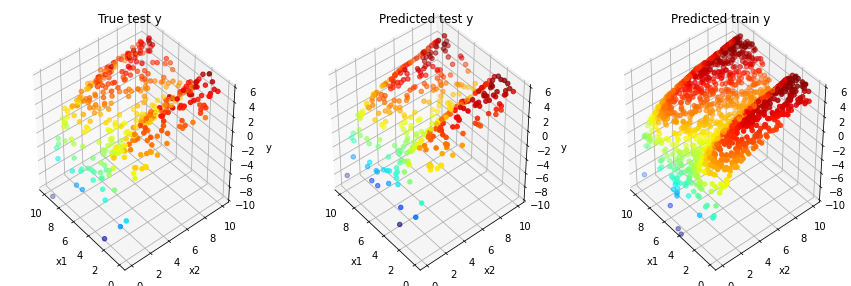


 Epoch: 1880, loss: 0.3455


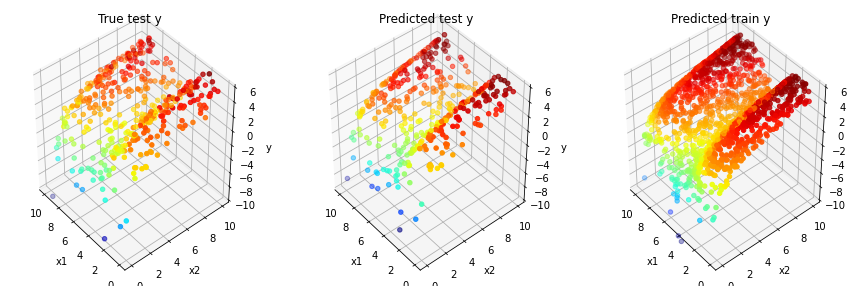


 Epoch: 1900, loss: 0.3587


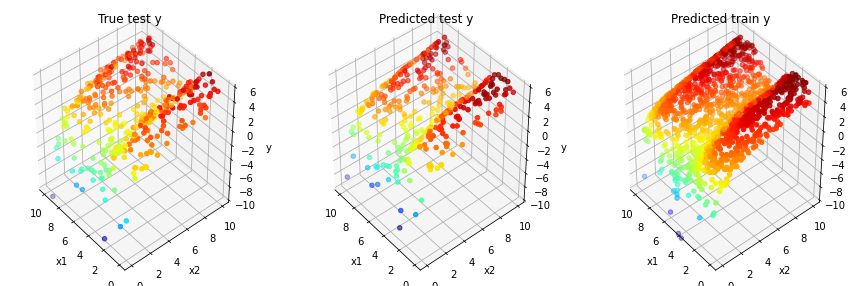


 Epoch: 1920, loss: 0.4999


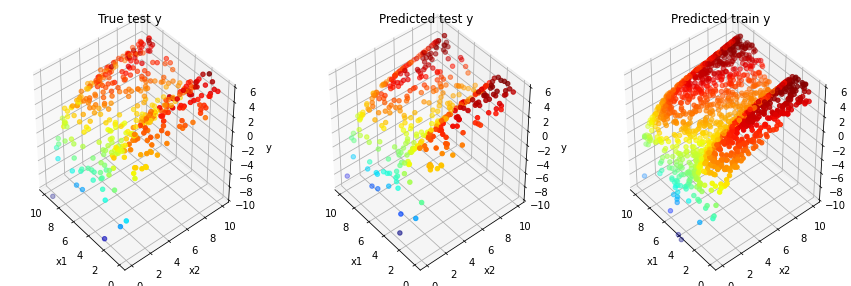


 Epoch: 1940, loss: 0.3279


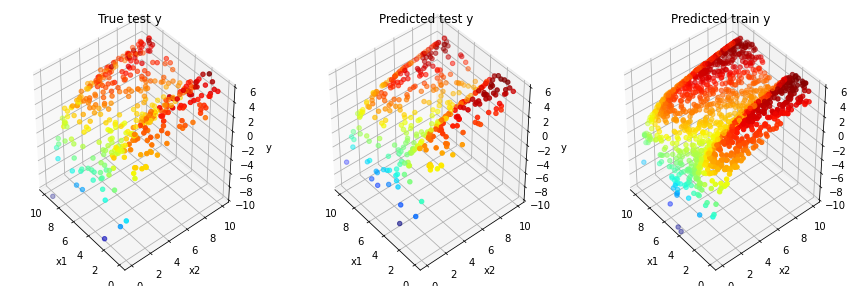


 Epoch: 1960, loss: 0.3974


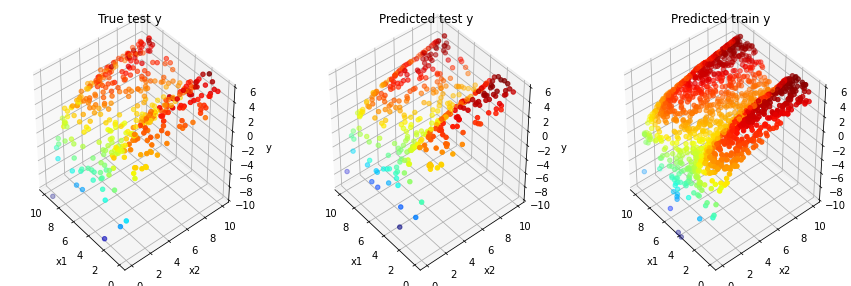


 Epoch: 1980, loss: 0.4006
Elapsed time: 75 sec


In [11]:
ts = time.time()

seed = 123
np.random.seed(seed)
torch.manual_seed(seed)

parser = argparse.ArgumentParser()

args = parser.parse_args("")

args.in_dim = 2
args.out_dim = 1
args.hid_dim = 100

args.n_layers = 5
args.act = 'relu'
args.dropout = 0.1
args.use_bn = 'True'
args.use_xavier='True'

args.lr = 0.01
args.momentum = 0.9
args.epoch = 2000

list_epoch, list_train_loss, list_val_loss, list_acc, list_acc_epoch = experiment(args)

te = time.time()

print('Elapsed time: {} sec'.format(int(te-ts)))

In [12]:
print(args)

Namespace(act='relu', dropout=0.1, epoch=2000, hid_dim=100, in_dim=2, lr=0.01, momentum=0.9, n_layers=5, out_dim=1, use_bn='True', use_xavier='True')


# 5. Report  


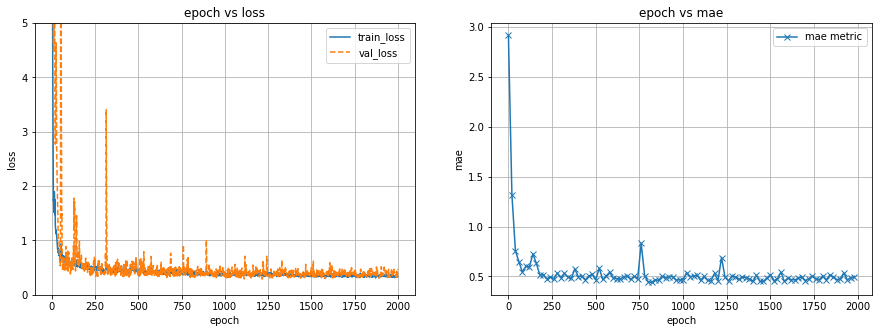

In [13]:
fig = plt.figure(figsize=(15,5))

# ====== Loss Fluctuation ====== #
ax1 = fig.add_subplot(1, 2, 1)
ax1.plot(list_epoch, list_train_loss, label='train_loss')
ax1.plot(list_epoch, list_val_loss, '--', label='val_loss')
ax1.set_xlabel('epoch')
ax1.set_ylabel('loss')
ax1.set_ylim(0, 5)
ax1.grid()
ax1.legend()
ax1.set_title('epoch vs loss')

# ====== Metric Fluctuation ====== #
ax2 = fig.add_subplot(1, 2, 2)
ax2.plot(list_acc_epoch, list_acc, marker='x', label='mae metric')

ax2.set_xlabel('epoch')
ax2.set_ylabel('mae')
ax2.grid()
ax2.legend()
ax2.set_title('epoch vs mae')


plt.show()